# Use YOLOv5 from Ultralytics for transfer learning to detect chest abnormalities

In [1]:
#@title Version notes { run: "auto" }
version_notes = "Filter outliers (bbox size) with Gaussian model, Augs: translate - 0.2, scale - 0.6, flip up - 0, flip lr - 0.5, mosaic - 1.0" #@param {type:"string"}
version_codeword = "outliers" #@param {type:"string"}

In [2]:
#@title YOLO parameters { run:"auto" }

MODEL_VERSION = "yolov5x" #@param ["yolov5s", "yolov5m", "yolov5l", "yolov5x"]
HYP_TYPE = "scratch" #@param ["scratch", "finetune"]

EPOCHS = 40 #@param {type:"slider", min:0, max:300, step:5}

WBF_IOU = 0.4 #@param {type:"slider", min:0, max:1, step:0.01}

DETECT_IOU = 0.6 #@param {type:"slider", min:0, max:1, step:0.01}
DETECT_CONF = 0.01 #@param {type:"slider", min:0, max:1, step:0.01}

IMAGE_SIZE = 640 #@param {type:"slider", min:512, max:1024, step:64}

VALID_SPLIT = 0.2 #@param {type:"slider", min:0, max:1, step:0.01}

N_FOLD = 5 #@param {type:"slider", min:3, max:10, step:1}
CURRENT_FOLD = 4 #@param {type:"slider", min:0, max:4, step:1}
assert(CURRENT_FOLD >= 0 and CURRENT_FOLD < N_FOLD)

In [3]:
BATCH_SIZE = { "yolov5s": 32, "yolov5m": 16, "yolov5l": 8, "yolov5x": 4 }[MODEL_VERSION]
if IMAGE_SIZE <= 640:
    BATCH_SIZE *= 2

EXPERIMENT_NAME = f"{MODEL_VERSION}_{version_codeword}_{EPOCHS}epochs_{IMAGE_SIZE}image_fold{CURRENT_FOLD}of{N_FOLD}_WBFat{WBF_IOU}iou_det{DETECT_IOU}iou{DETECT_CONF}conf"
assert(EXPERIMENT_NAME.find(" ") == -1)
print("Experiment name:", EXPERIMENT_NAME)

Experiment name: yolov5x_outliers_40epochs_640image_fold4of5_WBFat0.4iou_det0.6iou0.01conf


## Setup

In [4]:
try:
    from google.colab import drive
    drive.mount("/content/drive")
    %cd /content/drive/MyDrive/Colab\ Notebooks/kaggle
    from setup_colab import setup_colab_for_kaggle, WORK_FOLDER, OUTPUT_FOLDER, dump_dataset_metadata
    setup_colab_for_kaggle(check_env=False, local_working=True)
except:
    print("Not in Colab")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/Colab Notebooks/kaggle
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Content of Drive Kaggle data dir (/content/drive/MyDrive/kaggle): ['/content/drive/MyDrive/kaggle/input', '/content/drive/MyDrive/kaggle/working', '/content/drive/MyDrive/kaggle/.ipynb_checkpoints', '/content/drive/MyDrive/kaggle/output']
Content of Kaggle data dir (/kaggle): ['/kaggle/working', '/kaggle/output', '/kaggle/input']
Content of Kaggle data subdir (/kaggle/input): ['/kaggle/input/cassava-model', '/kaggle/input/cassava-leaf-disease-classification', '/kaggle/input/googlebitemperedloss', '/kaggle/input/vbdyolo', '/kaggle/input/.ipynb_checkpoints', '/kaggle/input/vinbigdata', '/kaggle/input/vinbigdata-chest-xray-abnormalities-detection', '/kaggle/input/vinbigdata-chest-xray-origi

In [5]:
from pathlib import Path
import shutil

from IPython.display import Image, clear_output

import numpy as np
import pandas as pd
from tqdm.notebook import tqdm

np.random.seed(0)

INPUT_FOLDER_DATA = WORK_FOLDER / "vinbigdata-chest-xray-abnormalities-detection"
INPUT_FOLDER_PNG = WORK_FOLDER / "vinbigdata"
INPUT_FOLDER_YOLO = WORK_FOLDER / "vbdyolo"
OUTPUT_FOLDER_CUR = OUTPUT_FOLDER / "vbdyolo-out"

## Prepare the dataset

In [6]:
!pip install git+https://github.com/Witalia008/kaggle-api.git@fix-datasets-download-file-unzip
clear_output()

Download the competition dataset's `train.csv`

In [7]:
!kaggle competitions download vinbigdata-chest-xray-abnormalities-detection -f train.csv -p {INPUT_FOLDER_DATA} --unzip

  0% 0.00/1.79M [00:00<?, ?B/s]
100% 1.79M/1.79M [00:00<00:00, 153MB/s]


Download the dataset with PNG images 1024x1024

In [8]:
!kaggle datasets download xhlulu/vinbigdata-chest-xray-resized-png-1024x1024 -p {INPUT_FOLDER_PNG} --unzip

100% 7.34G/7.35G [01:43<00:00, 58.3MB/s]
100% 7.35G/7.35G [01:43<00:00, 76.1MB/s]


### Read the dataset and normalize

In [9]:
train_df = pd.read_csv(Path(INPUT_FOLDER_DATA, "train.csv"))
train_meta_df = pd.read_csv(Path(INPUT_FOLDER_PNG, "train_meta.csv"))
train_df = train_df.merge(train_meta_df, on="image_id")
train_df = train_df[train_df["class_name"] != "No finding"].reset_index(drop=True)

# NOTE: For some reason, dim0 is in fact y-axis, and dim1 is x-axis!
train_df[["dim0", "dim1"]] = train_df[["dim1", "dim0"]]

# Normalize the coordinates.
train_df[["x_min", "x_max"]] = train_df[["x_min", "x_max"]].div(train_df["dim0"], axis=0)
train_df[["y_min", "y_max"]] = train_df[["y_min", "y_max"]].div(train_df["dim1"], axis=0)

display(train_df.head(2))
display(train_df.shape)

,image_id,class_name,class_id,rad_id,x_min,y_min,x_max,y_max,dim0,dim1
0,9a5094b2563a1ef3ff50dc5c7ff71345,Cardiomegaly,3,R10,0.332212,0.588613,0.794712,0.783818,2080,2336
1,9a5094b2563a1ef3ff50dc5c7ff71345,Pleural effusion,10,R9,0.860096,0.740154,0.901442,0.852740,2080,2336


(36096, 10)

In [10]:
# Use the pair (class_name, class_id) as index to get unique combinations
classes = train_df.set_index(["class_name", "class_id"]).index.unique().to_frame()
# We got it as multi-index, convert to columns, drop the old index, and sort.
classes = classes.reset_index(drop=True).sort_values(by="class_id").reset_index(drop=True)
classes

,class_name,class_id
0,Aortic enlargement,0
1,Atelectasis,1
2,Calcification,2
3,Cardiomegaly,3
4,Consolidation,4
5,ILD,5
6,Infiltration,6
7,Lung Opacity,7
8,Nodule/Mass,8
9,Other lesion,9


### Filter bboxes



Drop too large boxes (i.e. outliers according to distributions of sizes from EDA)

In [11]:
train_df["area"] = (train_df["x_max"] - train_df["x_min"]) * (train_df["y_max"] - train_df["y_min"])

Filter using quantiles

In [12]:
# for class_id, class_quantile in train_df.groupby("class_id").area.agg(lambda x: [x.quantile(0.01), x.quantile(.98)]).iteritems():
#     # Within the current class, filter those below 1% quantile and above 98% quantile.
#     train_df = train_df[~((train_df.class_id == class_id) & ((train_df.area < class_quantile[0]) | (train_df.area > class_quantile[1])))]

Filter using Gaussian model method

In [13]:
p_epsilon = 0.1

train_df_filtered = pd.DataFrame(columns=train_df.columns)

for class_id, bbox_areas in train_df.groupby("class_id")["area"]:
    # For current class, estimate Gaussian distribution.
    mu = bbox_areas.mean()
    sigma = bbox_areas.std()

    # Calculate Gaussian distribution probability for each area.
    def gaussian(x):
        return (1 / (sigma * np.sqrt(2 * np.pi))) * np.exp(-1 / 2 * np.square((x - mu) / sigma))

    train_df_cur_class = train_df[train_df["class_id"] == class_id]
    train_df_cur_class_area_gaussian = train_df_cur_class["area"].apply(gaussian)

    # Filter those with p < epsilon
    # print(class_id, [mu, sigma], train_df_cur_class[train_df_cur_class_area_gaussian < p_epsilon]["area"].tolist())
    train_df_filtered = train_df_filtered.append(train_df_cur_class[train_df_cur_class_area_gaussian >= p_epsilon])

train_df = train_df_filtered

Number of labels after filtering

In [14]:
print(train_df.shape)

(35459, 11)


### Reduce the bboxes

In [15]:
!pip install ensemble-boxes
clear_output()

In [16]:
from ensemble_boxes import *

def reduce_wbf(bbox_df, iou_thr=WBF_IOU):
    result_df = pd.DataFrame(columns=["image_id", "class_id", "x_min", "y_min", "x_max", "y_max"])

    for image_id, image_group in tqdm(bbox_df.groupby("image_id"), total=bbox_df.image_id.nunique()):
        boxes, scores, labels = [], [], []

        for rad_id, grouped_bboxes in image_group.groupby("rad_id"):
            boxes.append(grouped_bboxes[["x_min", "y_min", "x_max", "y_max"]].values.tolist())
            scores.append([1.0] * len(boxes[-1]))  # 1.0 for each of cur rad's boxes.
            labels.append(grouped_bboxes["class_id"].values.tolist())

        weights = None  # Presume all radiologists equal.

        boxes, scores, labels = weighted_boxes_fusion(boxes, scores, labels, weights=weights, iou_thr=iou_thr)

        for box, label in zip(boxes, labels):
            result_df = result_df.append({
                "image_id": image_id,
                "class_id": int(label),
                "x_min": box[0],
                "y_min": box[1],
                "x_max": box[2],
                "y_max": box[3]
            }, ignore_index=True)

    return result_df

train_df = reduce_wbf(train_df)
display(train_df.head(5))
display(train_df.shape)

,image_id,class_id,x_min,y_min,x_max,y_max
0,0005e8e3701dfb1dd93d53e2ff537b6e,7,0.293783,0.190430,0.391927,0.289388
1,0005e8e3701dfb1dd93d53e2ff537b6e,8,0.303385,0.184570,0.389648,0.291667
2,0005e8e3701dfb1dd93d53e2ff537b6e,4,0.303385,0.184570,0.389648,0.291667
3,0005e8e3701dfb1dd93d53e2ff537b6e,6,0.292969,0.191081,0.392253,0.289062
4,0007d316f756b3fa0baea2ff514ce945,0,0.544705,0.357639,0.646701,0.437847


(22347, 6)

### Convert to YOLO coordinates

In [17]:
# Get YOLO coordinates
train_df["x_centre"] = (train_df["x_min"] + train_df["x_max"]) / 2
train_df["y_centre"] = (train_df["y_min"] + train_df["y_max"]) / 2
train_df["bw"] = train_df["x_max"] - train_df["x_min"]
train_df["bh"] = train_df["y_max"] - train_df["y_min"]

train_df.head(2)

,image_id,class_id,x_min,y_min,x_max,y_max,x_centre,y_centre,bw,bh
0,0005e8e3701dfb1dd93d53e2ff537b6e,7,0.293783,0.19043,0.391927,0.289388,0.342855,0.239909,0.098145,0.098958
1,0005e8e3701dfb1dd93d53e2ff537b6e,8,0.303385,0.18457,0.389648,0.291667,0.346517,0.238118,0.086263,0.107096


Get image-based train and validation splits

In [18]:
from sklearn.model_selection import GroupShuffleSplit
import itertools

gss: GroupShuffleSplit = GroupShuffleSplit(n_splits=N_FOLD, test_size=VALID_SPLIT, random_state=32)
# Get CURRENT_FOLD'th element from splits.
train_idx, valid_idx = next(itertools.islice(gss.split(train_df, groups=train_df["image_id"].to_list()), CURRENT_FOLD, None))
train_data, valid_data = train_df.iloc[train_idx], train_df.iloc[valid_idx]
len(train_data), len(valid_data)

(17873, 4474)

Extract bboxes for yolo from train data

In [19]:
def get_yolo_labels_txt(image_labels):
    return image_labels[["class_id", "x_centre", "y_centre", "bw", "bh"]].to_string(header=False, index=False)

In [20]:
# Remove dataset if there's anything already.
if INPUT_FOLDER_YOLO.exists():
    shutil.rmtree(INPUT_FOLDER_YOLO)

INPUT_FOLDER_YOLO.mkdir()

for set_name, data in zip(["train", "valid"], [train_data, valid_data]):
    (INPUT_FOLDER_YOLO / "images" / set_name).mkdir(parents=True)
    (INPUT_FOLDER_YOLO / "labels" / set_name).mkdir(parents=True)

    for image_id, image_grouped_labels in tqdm(data.groupby("image_id"), total=data["image_id"].nunique()):
        image_file_name = f"{image_id}.png"
        shutil.copyfile(
            INPUT_FOLDER_PNG / "train" / image_file_name,
            INPUT_FOLDER_YOLO / "images" / set_name / image_file_name,
        )
        with open(INPUT_FOLDER_YOLO / "labels" / set_name / f"{image_id}.txt", "w") as f:
            f.write(get_yolo_labels_txt(image_grouped_labels))

In [21]:
# Just copy all the test files as well.
shutil.copytree(INPUT_FOLDER_PNG / "test", INPUT_FOLDER_YOLO / "images" / "test")

PosixPath('/kaggle/working/vbdyolo/images/test')

Store the dataset definition

In [22]:
import yaml

class_names = classes["class_name"].values

dataset_config = {
    "nc": len(class_names),
    "names": list(class_names),
    "train": "images/train",
    "val": "images/valid"
}

with open(INPUT_FOLDER_YOLO / "vbd-dataset.yaml", "w") as f:
    yaml.dump(dataset_config, f, default_flow_style=False)

## Get YOLOv5 and install its requirements

In [23]:
%cd $WORK_FOLDER
!rm -rf yolov5 && git clone https://github.com/ultralytics/yolov5 && git checkout tags/v4.0
%cd yolov5
%pip install -qr requirements.txt

/kaggle/working
Cloning into 'yolov5'...
remote: Enumerating objects: 40, done.
remote: Counting objects: 100% (40/40), done.
remote: Compressing objects: 100% (32/32), done.
remote: Total 5532 (delta 16), reused 20 (delta 8), pack-reused 5492
Receiving objects: 100% (5532/5532), 8.15 MiB | 16.53 MiB/s, done.
Resolving deltas: 100% (3770/3770), done.
fatal: not a git repository (or any of the parent directories): .git
/kaggle/working/yolov5


In [24]:
import torch

clear_output()
print(f"Setup complete. Using torch {torch.__version__} {torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'}")

Setup complete. Using torch 1.8.0+cu101 _CudaDeviceProperties(name='Tesla V100-SXM2-16GB', major=7, minor=0, total_memory=16160MB, multi_processor_count=80)


## Prepare the model

In [25]:
%pip install ruamel.yaml
clear_output()

from ruamel.yaml import YAML

### Update hyperparameters

In [26]:
yaml = YAML()
model_hyperparameters_file = Path("data", f"hyp.{HYP_TYPE}.yaml")
model_hyperparameters = yaml.load(model_hyperparameters_file)

# Set IoU training threshold
# model_hyperparameters["iou_t"] = 0.2
# Disable HSV augmentations
# model_hyperparameters["hsv_h"] = 0.0
# model_hyperparameters["hsv_s"] = 0.0
# model_hyperparameters["hsv_v"] = 0.0
# Only slight augs: Image rotation/translation/scale/perspective
model_hyperparameters["degrees"] = 0.0  # image rotation (+/- deg)
model_hyperparameters["translate"] = 0.2  # image translation (+/- fraction)
model_hyperparameters["scale"] = 0.6  # image scale (+/- gain)
model_hyperparameters["shear"] = 0.0  # image shear (+/- deg)
model_hyperparameters["perspective"] = 0.0  # image perspective (+/- fraction), range 0-0.001
# Disable flips
model_hyperparameters["flipud"] = 0.0  # image flip up-down (probability)
model_hyperparameters["fliplr"] = 0.5  # image flip left-right (probability)
# Slight mosaic and disable mixup augs
model_hyperparameters["mosaic"] = 1.0  # image mosaic (probability)
model_hyperparameters["mixup"] = 0.0  # image mixup (probability)

print(model_hyperparameters)
yaml.dump(model_hyperparameters, model_hyperparameters_file)

ordereddict([('lr0', 0.01), ('lrf', 0.2), ('momentum', 0.937), ('weight_decay', 0.0005), ('warmup_epochs', 3.0), ('warmup_momentum', 0.8), ('warmup_bias_lr', 0.1), ('box', 0.05), ('cls', 0.5), ('cls_pw', 1.0), ('obj', 1.0), ('obj_pw', 1.0), ('iou_t', 0.2), ('anchor_t', 4.0), ('fl_gamma', 0.0), ('hsv_h', 0.015), ('hsv_s', 0.7), ('hsv_v', 0.4), ('degrees', 0.0), ('translate', 0.2), ('scale', 0.6), ('shear', 0.0), ('perspective', 0.0), ('flipud', 0.0), ('fliplr', 0.5), ('mosaic', 1.0), ('mixup', 0.0)])


### Update dataset config paths

In [27]:
yaml = YAML()
dataset_config = yaml.load(INPUT_FOLDER_YOLO / "vbd-dataset.yaml")
dataset_config["train"] = str(INPUT_FOLDER_YOLO / dataset_config["train"])
dataset_config["val"] = str(INPUT_FOLDER_YOLO / dataset_config["val"])
print(dataset_config)
yaml.dump(dataset_config, INPUT_FOLDER_YOLO / "vbd-dataset.yaml")

ordereddict([('names', ['Aortic enlargement', 'Atelectasis', 'Calcification', 'Cardiomegaly', 'Consolidation', 'ILD', 'Infiltration', 'Lung Opacity', 'Nodule/Mass', 'Other lesion', 'Pleural effusion', 'Pleural thickening', 'Pneumothorax', 'Pulmonary fibrosis']), ('nc', 14), ('train', '/kaggle/working/vbdyolo/images/train'), ('val', '/kaggle/working/vbdyolo/images/valid')])


### Update config

In [28]:
yaml = YAML()
model_config_file = Path("models", f"{MODEL_VERSION}.yaml")
model_config = yaml.load(model_config_file)
model_config["nc"] = dataset_config["nc"]
print(model_config)
yaml.dump(model_config, model_config_file)

ordereddict([('nc', 14), ('depth_multiple', 1.33), ('width_multiple', 1.25), ('anchors', [[10, 13, 16, 30, 33, 23], [30, 61, 62, 45, 59, 119], [116, 90, 156, 198, 373, 326]]), ('backbone', [[-1, 1, 'Focus', [64, 3]], [-1, 1, 'Conv', [128, 3, 2]], [-1, 3, 'C3', [128]], [-1, 1, 'Conv', [256, 3, 2]], [-1, 9, 'C3', [256]], [-1, 1, 'Conv', [512, 3, 2]], [-1, 9, 'C3', [512]], [-1, 1, 'Conv', [1024, 3, 2]], [-1, 1, 'SPP', [1024, [5, 9, 13]]], [-1, 3, 'C3', [1024, False]]]), ('head', [[-1, 1, 'Conv', [512, 1, 1]], [-1, 1, 'nn.Upsample', ['None', 2, 'nearest']], [[-1, 6], 1, 'Concat', [1]], [-1, 3, 'C3', [512, False]], [-1, 1, 'Conv', [256, 1, 1]], [-1, 1, 'nn.Upsample', ['None', 2, 'nearest']], [[-1, 4], 1, 'Concat', [1]], [-1, 3, 'C3', [256, False]], [-1, 1, 'Conv', [256, 3, 2]], [[-1, 14], 1, 'Concat', [1]], [-1, 3, 'C3', [512, False]], [-1, 1, 'Conv', [512, 3, 2]], [[-1, 10], 1, 'Concat', [1]], [-1, 3, 'C3', [1024, False]], [[17, 20, 23], 1, 'Detect', ['nc', 'anchors']]])])


## Train

In [29]:
%pip install -q wandb
clear_output()
!wandb login

wandb: Currently logged in as: witalia (use `wandb login --relogin` to force relogin)


In [30]:
# For some reason "cache" option crashes silently on 1024 images
!python train.py \
    --name {EXPERIMENT_NAME} \
    --img {IMAGE_SIZE} \
    --batch {BATCH_SIZE} \
    --epochs {EPOCHS} \
    --data {INPUT_FOLDER_YOLO}/vbd-dataset.yaml \
    --weights {MODEL_VERSION}.pt \
    --hyp data/hyp.{HYP_TYPE}.yaml \
    --exist-ok
    #--cache

# Make sure to collect the trained model
!mkdir -p {OUTPUT_FOLDER_CUR}
# Remove any previous models.
!rm {OUTPUT_FOLDER_CUR}/yolov5_xray_best.pt {OUTPUT_FOLDER_CUR}/yolov5_xray.pt
!cp runs/train/{EXPERIMENT_NAME}/weights/best.pt {OUTPUT_FOLDER_CUR}/yolov5_xray_best.pt
!cp runs/train/{EXPERIMENT_NAME}/weights/last.pt {OUTPUT_FOLDER_CUR}/yolov5_xray.pt

github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v4.0-160-g005d7a8 torch 1.8.0+cu101 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

Namespace(adam=False, artifact_alias='latest', batch_size=8, bbox_interval=-1, bucket='', cache_images=False, cfg='', data='/kaggle/working/vbdyolo/vbd-dataset.yaml', device='', entity=None, epochs=40, evolve=False, exist_ok=True, global_rank=-1, hyp='data/hyp.scratch.yaml', image_weights=False, img_size=[640, 640], linear_lr=False, local_rank=-1, multi_scale=False, name='yolov5x_outliers_40epochs_640image_fold4of5_WBFat0.4iou_det0.6iou0.01conf', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/yolov5x_outliers_40epochs_640image_fold4of5_WBFat0.4iou_det0.6iou0.01conf', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=8, upload_dataset=False, weights='yolov5x.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/trai

## Visualize training results

In [31]:
%reload_ext tensorboard
%tensorboard --logdir runs/train

Output hidden; open in https://colab.research.google.com to view.

In [32]:
import matplotlib.pyplot as plt

### Labels info

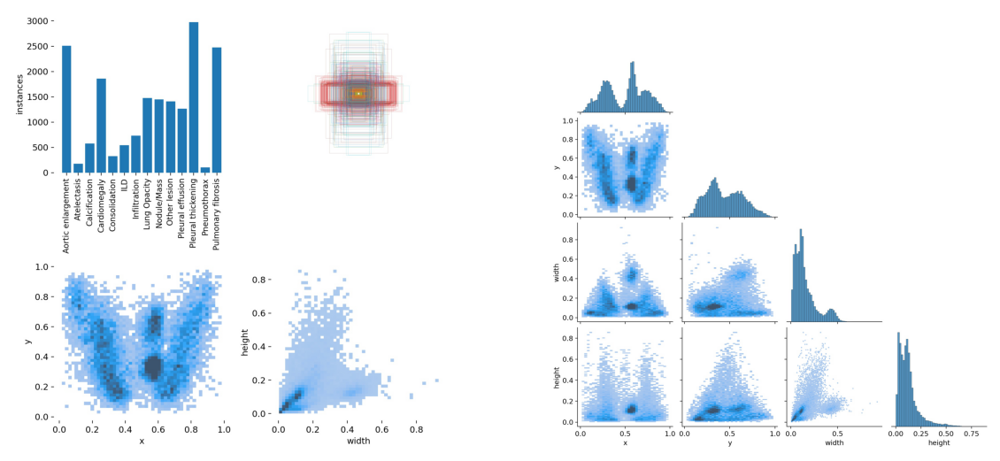

In [33]:
_, ax = plt.subplots(1, 2, figsize=(20, 10))
ax[0].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/labels.jpg"))
ax[0].axis("off")
ax[1].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/labels_correlogram.jpg"))
_ = ax[1].axis("off")

### Train results

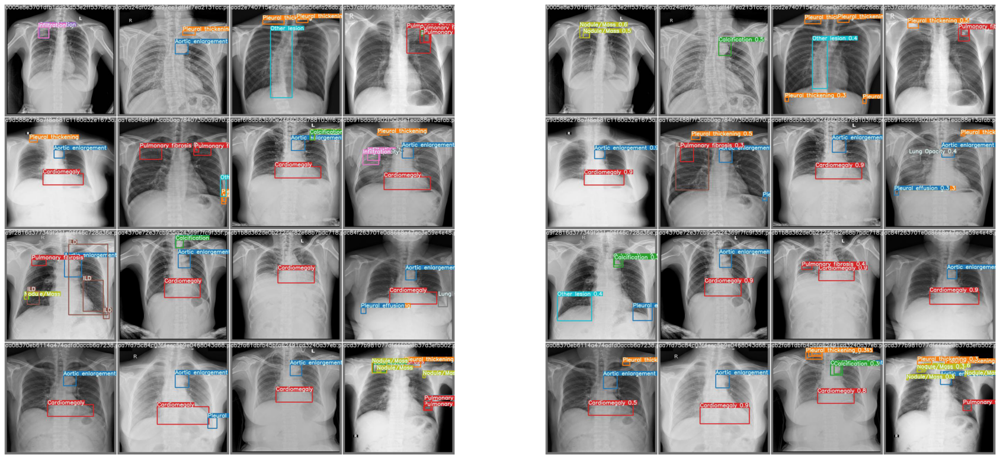

In [34]:
_, ax = plt.subplots(1, 2, figsize=(30, 15))
ax[0].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/test_batch0_labels.jpg"))
ax[0].axis("off")
ax[1].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/test_batch0_pred.jpg"))
_ = ax[1].axis("off")

### Learning curves

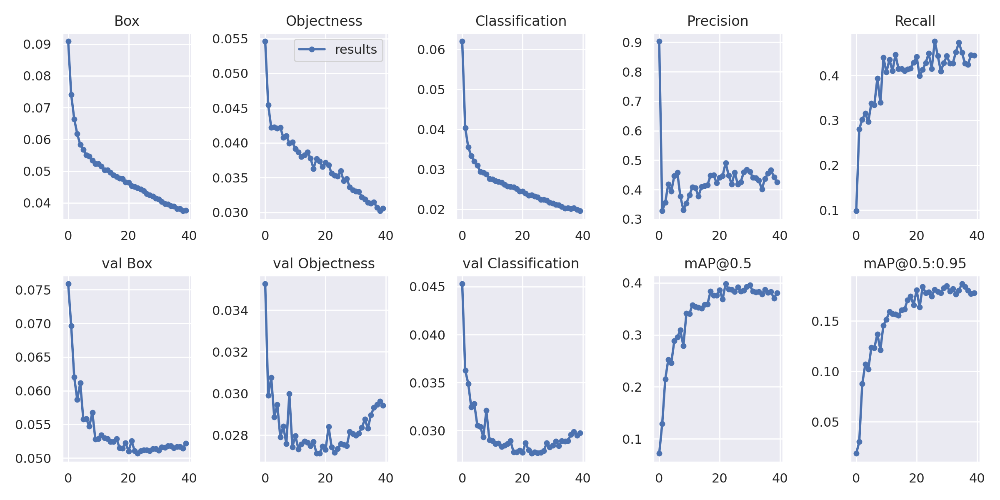

In [35]:
Image(filename=f"runs/train/{EXPERIMENT_NAME}/results.png", width=1200)

F1 curve

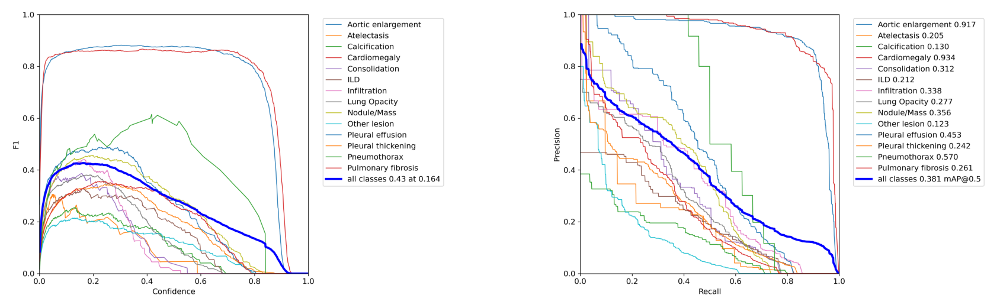

In [36]:
_, ax = plt.subplots(1, 2, figsize=(30, 15))
ax[0].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/F1_curve.png"))
ax[0].axis("off")
ax[1].imshow(plt.imread(f"runs/train/{EXPERIMENT_NAME}/PR_curve.png"))
_ = ax[1].axis("off")

PR curve

### Confusion matrix

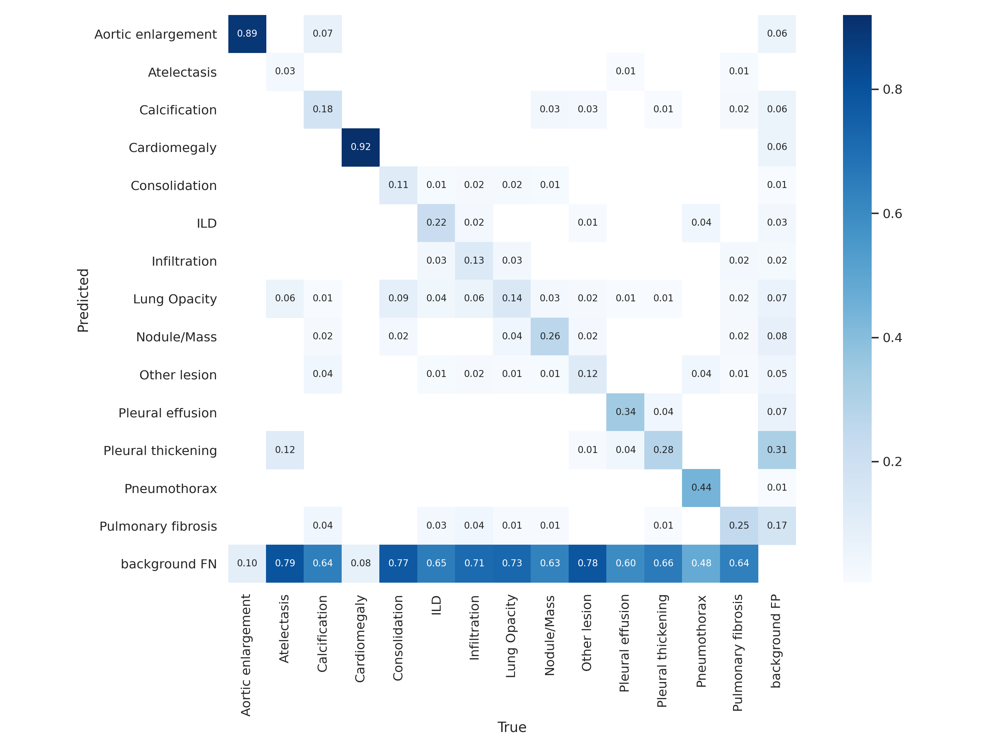

In [37]:
Image(filename=f"runs/train/{EXPERIMENT_NAME}/confusion_matrix.png", width=800)

## Run predictions

In [38]:
# Smaller conf thresh?
# Use --agnostic-nms to run class-agnostic NMS?
# Use --augment for TTA?
!python detect.py \
    --name {EXPERIMENT_NAME} \
    --weights {OUTPUT_FOLDER_CUR}/yolov5_xray_best.pt \
    --img {IMAGE_SIZE} \
    --conf-thres {DETECT_CONF} \
    --iou-thres {DETECT_IOU} \
    --source {INPUT_FOLDER_YOLO}/images/test \
    --save-txt \
    --save-conf

# Make sure to collect predictions.
!ls runs/detect/{EXPERIMENT_NAME}/labels/ | wc -l
# Make sure to delete any exising labels in the folder, since they will get merged.
!rm -rf {OUTPUT_FOLDER_CUR}/labels_pred/
!mkdir -p {OUTPUT_FOLDER_CUR}/labels_pred/
!cp -r runs/detect/{EXPERIMENT_NAME}/labels/*.txt {OUTPUT_FOLDER_CUR}/labels_pred/

Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.01, device='', exist_ok=False, img_size=640, iou_thres=0.6, name='yolov5x_outliers_40epochs_640image_fold4of5_WBFat0.4iou_det0.6iou0.01conf', nosave=False, project='runs/detect', save_conf=True, save_txt=True, source='/kaggle/working/vbdyolo/images/test', update=False, view_img=False, weights=['/kaggle/output/vbdyolo-out/yolov5_xray_best.pt'])
YOLOv5 🚀 v4.0-160-g005d7a8 torch 1.8.0+cu101 CUDA:0 (Tesla V100-SXM2-16GB, 16160.5MB)

Fusing layers... 
Model Summary: 476 layers, 87286171 parameters, 0 gradients, 217.4 GFLOPS
image 1/3000 /kaggle/working/vbdyolo/images/test/002a34c58c5b758217ed1f584ccbcfe9.png: 640x640 1 Aortic enlargement, 1 Cardiomegaly, 1 ILD, 16 Pleural thickenings, Done. (0.016s)
image 2/3000 /kaggle/working/vbdyolo/images/test/004f33259ee4aef671c2b95d54e4be68.png: 640x640 1 Aortic enlargement, 2 Lung Opacitys, 2 Pleural effusions, 3 Pleural thickenings, Done. (0.015s)
image 3/3000 /kaggle/working/vb

## Predictions visualizations

In [39]:
import numpy as np
sample_predictions = list(Path(f"runs/detect/{EXPERIMENT_NAME}").glob("*.png"))
sample_predictions = np.random.choice(sample_predictions, 6)

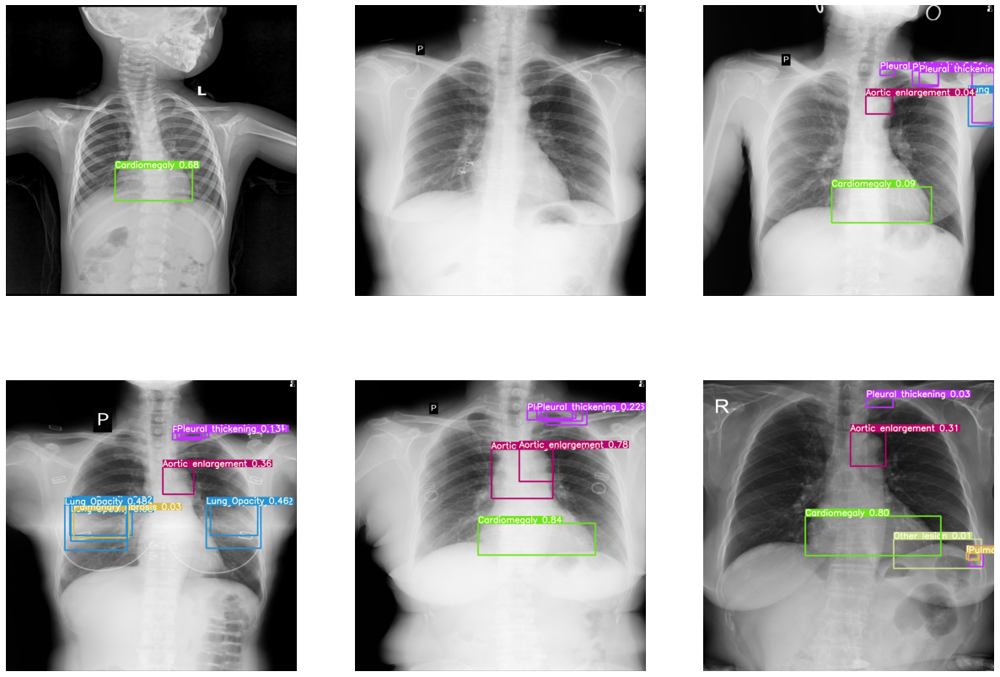

In [40]:
_, ax = plt.subplots(2, 3, figsize=(21, 15))
ax = ax.reshape(-1)
for ax, img_path in zip(ax, sample_predictions):
    ax.imshow(plt.imread(img_path))
    ax.axis("off")

## Store output to kaggle

In [41]:
version_message = " --- ".join([
    version_notes,
    "; ".join([
        f"Fold: {CURRENT_FOLD}/{N_FOLD}",
        f"WBF preproc IoU: {WBF_IOU}",
        f"version: {MODEL_VERSION}",
        f"epochs: {EPOCHS}",
        f"valid split: {100 * VALID_SPLIT}%",
        f"image size: {IMAGE_SIZE}",
        f"detect IoU: {DETECT_IOU}",
        f"detect conf: {DETECT_CONF}",
        f"exp: {EXPERIMENT_NAME}",
    ])
])
!echo "{version_message}"
dump_dataset_metadata("witalia", "vbdyolo-out-newest", OUTPUT_FOLDER_CUR)
# !kaggle datasets create -p {OUTPUT_FOLDER_CUR} -r zip
!kaggle datasets version -m "{version_message}" -p {OUTPUT_FOLDER_CUR} -r zip

Filter outliers (bbox size) with Gaussian model, Augs: translate - 0.2, scale - 0.6, flip up - 0, flip lr - 0.5, mosaic - 1.0 --- Fold: 4/5; WBF preproc IoU: 0.4; version: yolov5x; epochs: 40; valid split: 20.0%; image size: 640; detect IoU: 0.6; detect conf: 0.01; exp: yolov5x_outliers_40epochs_640image_fold4of5_WBFat0.4iou_det0.6iou0.01conf
Starting upload for file .ipynb_checkpoints.zip
100% 22.0/22.0 [00:04<00:00, 5.00B/s]
Upload successful: .ipynb_checkpoints.zip (22B)
Starting upload for file yolov5_xray_best.pt
100% 167M/167M [00:10<00:00, 17.1MB/s]
Upload successful: yolov5_xray_best.pt (167MB)
Starting upload for file yolov5_xray.pt
100% 167M/167M [00:10<00:00, 17.3MB/s]
Upload successful: yolov5_xray.pt (167MB)
Starting upload for file labels_pred.zip
100% 1.23M/1.23M [00:05<00:00, 228kB/s]
Upload successful: labels_pred.zip (1MB)
Dataset version is being created. Please check progress at https://www.kaggle.com/witalia/vbdyolo-out-newest
